# ELE510 Project 06


# Feature Descriptors: Comparison of SIFT, FAST + BRIEF and ORB

### Install and import necessary libraries

In [20]:
!pip install opencv-contrib-python --user

In [21]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

## Implemention of the Algorithms

In [ ]:
def SIFT(img,show=True,nfeatures=500,flags=cv2.DrawMatchesFlags_DRAW_RICH_KEYPOINTS):
    # Initiate SIFT detector/descriptor
    sift = cv2.SIFT_create(nfeatures)

    # Find the keypoints and compute the descriptors with SIFT
    kp, des = sift.detectAndCompute(img, None)

    if show == True:
        imgWkeypoints = cv2.drawKeypoints(img,kp,None,flags=flags)
        cv2.imshow("SIFT",imgWkeypoints)
        cv2.waitKey(0)
        cv2.destroyAllWindows()

    return kp, des


Implementation based on
###### https://docs.opencv.org/3.4/da/df5/tutorial_py_sift_intro.html
###### https://medium.com/data-breach/introduction-to-sift-scale-invariant-feature-transform-65d7f3a72d40

In [22]:
def FASTBRIEF(img,thresh=10,show=True,flags=cv2.DrawMatchesFlags_DRAW_RICH_KEYPOINTS):
    # Initiate FAST detector
    fast = cv2.FastFeatureDetector_create(threshold=thresh)
    # Initiate BRIEF descriptor/extractor
    brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()

    # find the keypoints with FAST
    kp = fast.detect(img,None)
    # compute the descriptors with BRIEF
    kp, des = brief.compute(img, kp)

    if show == True:
        imgWkeypoints = cv2.drawKeypoints(img,kp,None,flags=flags)
        cv2.imshow("FAST + BRIEF",imgWkeypoints)
        cv2.waitKey(0)
        cv2.destroyAllWindows()

    return kp, des

Implementation based on
###### https://docs.opencv.org/3.4/df/d0c/tutorial_py_fast.html
###### https://docs.opencv.org/3.4/dc/d7d/tutorial_py_brief.html
###### https://medium.com/data-breach/introduction-to-fast-features-from-accelerated-segment-test-4ed33dde6d65
###### https://medium.com/data-breach/introduction-to-brief-binary-robust-independent-elementary-features-436f4a31a0e6

In [23]:
def ORB(img,show=True,nfeatures=500,flags=cv2.DrawMatchesFlags_DRAW_RICH_KEYPOINTS):
    # Initiate ORB detector/descriptor
    orb = cv2.ORB_create(nfeatures)
    
    # Find the keypoints and compute the descriptors with ORB
    kp, des = orb.detectAndCompute(img, None)

    if show == True:
        imgWkeypoints = cv2.drawKeypoints(img,kp,None,flags=flags)
        cv2.imshow("ORB",imgWkeypoints)
        cv2.waitKey(0)
        cv2.destroyAllWindows()

    return kp, des


Implementation based on
###### https://docs.opencv.org/3.4/d1/d89/tutorial_py_orb.html
###### https://medium.com/data-breach/introduction-to-orb-oriented-fast-and-rotated-brief-4220e8ec40cf

## Implementation of the Comparison

In [25]:
def compare(imgNames,imgPath='./images/', rotate=False, angle='random', 
            blurFAST=False,FASTthresh=1,nfeaturesORB=64,nfeaturesSIFT=16,show=False):
    #Initialise lists to store results for multiple images
    imgs = []
    rotimgs = []
    fastbrief_kps = []
    fastbrief_dess = []
    fastbrief_rotkps = []
    fastbrief_rotdess = []
    orb_kps = []
    orb_dess = []
    orb_rotkps = []
    orb_rotdess = []
    sift_kps = []
    sift_dess = []
    sift_rotkps = []
    sift_rotdess = []

    #for-loop to handle multiple images (with the same parameters)
    for ind, imgName in enumerate(imgNames):

        img = cv2.imread(imgPath+imgName,cv2.IMREAD_GRAYSCALE)
        
        #blur images befor applying FAST if the edges are too sharp
        if blurFAST == True:
            img_forFAST = cv2.GaussianBlur(img,ksize=(11,11),sigmaX=0)
        else:
            img_forFAST = img

        #find keypoints and calculate their descriptors using different algorithms
        fastbrief_kp, fastbrief_des = FASTBRIEF(img_forFAST,thresh = FASTthresh,show=show)
        orb_kp, orb_des = ORB(img,nfeatures = nfeaturesORB,show=show)
        sift_kp, sift_des = SIFT(img,nfeatures = nfeaturesSIFT,show=show)
        
        #append results to respective list
        imgs.append(img)
        
        fastbrief_kps.append(fastbrief_kp)
        fastbrief_dess.append(fastbrief_des)

        orb_kps.append(orb_kp)
        orb_dess.append(orb_des)

        sift_kps.append(sift_kp)
        sift_dess.append(sift_des)
        
        #perform same operations on rotated image, if desired
        if rotate == True:
            #rotate image
            h, w = img.shape[:2]
            cx, cy = (w // 2, h // 2)
            if angle == 'random':
                angle = np.random.randint(10,350)
            rotationM = cv2.getRotationMatrix2D([cx,cy],angle,1)
            rotimg = cv2.warpAffine(img,rotationM,(w,h))
            rotimg_forFAST = cv2.warpAffine(img_forFAST,rotationM,(w,h))
            rotimgs.append(rotimg)

            #find keypoints and calculate their descriptors using different algorithms
            fastbrief_rotkp, fastbrief_rotdes = FASTBRIEF(rotimg_forFAST,thresh = FASTthresh,show=show)
            orb_rotkp, orb_rotdes = ORB(rotimg,nfeatures = nfeaturesORB,show=show)
            sift_rotkp, sift_rotdes = SIFT(rotimg,nfeatures = nfeaturesSIFT,show=show)

            #append results to respective list
            fastbrief_rotkps.append(fastbrief_rotkp)
            fastbrief_rotdess.append(fastbrief_rotdes)

            orb_rotkps.append(orb_rotkp)
            orb_rotdess.append(orb_rotdes)

            sift_rotkps.append(sift_rotkp)
            sift_rotdess.append(sift_rotdes)
    
    if rotate == True:
        return imgs, rotimgs, fastbrief_kps, fastbrief_dess, fastbrief_rotkps, fastbrief_rotdess, orb_kps, orb_dess, orb_rotkps, orb_rotdess, sift_kps, sift_dess, sift_rotkps, sift_rotdess
    else:
        return imgs, fastbrief_kps, fastbrief_dess, orb_kps, orb_dess, sift_kps, sift_dess

In [26]:
def plot_comparison(imgs,fastbrief_kps,orb_kps,sift_kps,
                    SideBySide=False,flags=cv2.DrawMatchesFlags_DRAW_RICH_KEYPOINTS):
    #for-loop to handle multiple images (with the same parameters)
    for ind, img in enumerate(imgs):
        plt.figure(figsize=(60,60))
        ImWKeypoints_fastbrief = cv2.drawKeypoints(img,fastbrief_kps[ind],outImage=None,flags=flags)
        if SideBySide == True:
            plt.subplot(131)
        else:
            plt.subplot(311)
        plt.imshow(ImWKeypoints_fastbrief)
        plt.title('FAST + BRIEF')
        ImWKeypoints_orb = cv2.drawKeypoints(img,orb_kps[ind],outImage=None,flags=flags)
        if SideBySide == True:
            plt.subplot(132)
        else:
            plt.subplot(312)
        plt.imshow(ImWKeypoints_orb)
        plt.title('ORB')
        ImWKeypoints_sift = cv2.drawKeypoints(img,sift_kps[ind],outImage=None,flags=flags)
        if SideBySide == True:
            plt.subplot(133)
        else:
            plt.subplot(313)
        plt.imshow(ImWKeypoints_sift)
        plt.title('SIFT')
        plt.show()

## Chessboard

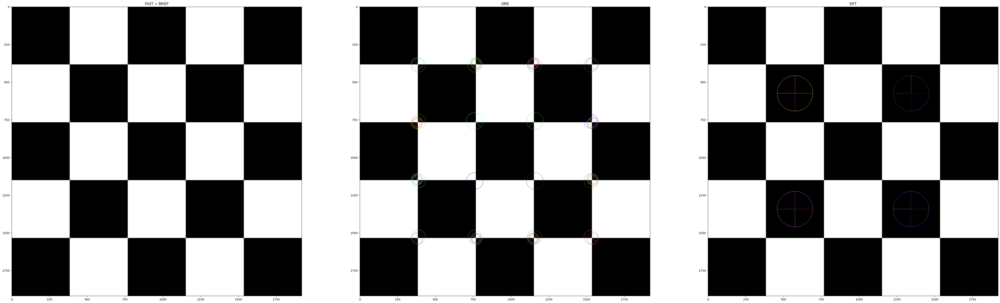

In [37]:
imgNames = ['chessboard.png']
imgs, fastbrief_kps, fastbrief_dess, orb_kps, orb_dess, sift_kps, sift_dess = compare(imgNames,
                                                                                    blurFAST = True,
                                                                                    FASTthresh = 1, 
                                                                                    nfeaturesORB = 64, 
                                                                                    nfeaturesSIFT = 16)
plot_comparison(imgs,fastbrief_kps,orb_kps,sift_kps,SideBySide=True)



### Feature Comparison for FAST + BRIEF

FAST + BRIEF descriptor feature 0:
 [224 234   4 138  52 237 214 103 157 202  85 135  75  40 223 181  82  51
 159  76 111 103  26 213 196  33  76 160  65 186 239 199] , 
1st byte in binary: 0b11100000

FAST + BRIEF descriptor feature 4:
 [224 234   4 138  52 237 214 103 157 202  85 135  75  40 223 181  82  51
 159  76 111 103  26 213 196  33  76 160  65 186 239 199] , 
1st byte in binary: 0b11100000

FAST + BRIEF descriptor feature 0 == feature 4?:
 [ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True]


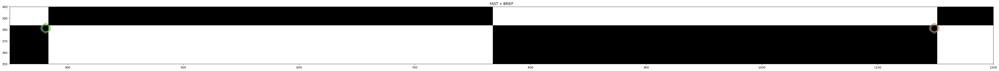

In [28]:
print('FAST + BRIEF descriptor feature 0:\n',fastbrief_dess[0][0],', \n1st byte in binary:',bin(fastbrief_dess[0][0][0]))
print('\nFAST + BRIEF descriptor feature 4:\n',fastbrief_dess[0][4],', \n1st byte in binary:',bin(fastbrief_dess[0][4][0]))
print('\nFAST + BRIEF descriptor feature 0 == feature 4?:\n',fastbrief_dess[0][0]==fastbrief_dess[0][4])

for ind, imgName in enumerate(imgNames):
    plt.figure(figsize=(60,60))
    ImWKeypoints_fastbrief = cv2.drawKeypoints(imgs[ind],[fastbrief_kps[ind][:][0],fastbrief_kps[ind][:][4]],outImage=None,flags=cv2.DrawMatchesFlags_DRAW_RICH_KEYPOINTS)
    plt.subplot(311)
    plt.imshow(ImWKeypoints_fastbrief)
    plt.xlim(350,1200)
    plt.ylim(350,400)
    plt.title('FAST + BRIEF')

### Performance Comparison (time)

In [29]:
img = cv2.imread('./images/chessboard.png',cv2.IMREAD_GRAYSCALE)
img_blurred = cv2.GaussianBlur(img,ksize=(11,11),sigmaX=0)
print('FAST + BRIEF:')
%timeit FASTBRIEF(img_blurred,thresh=1,show=False)
print('\nORB:')
%timeit ORB(img,nfeatures=64,show=False)
print('\nSIFT:')
%timeit SIFT(img,nfeatures=16,show=False)

FAST + BRIEF:
7.02 ms ± 542 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)

ORB:
27.9 ms ± 2.7 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)

SIFT:
649 ms ± 82 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


## Performance on Different Images

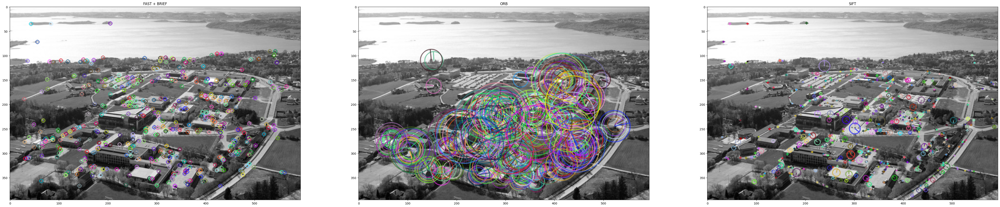

In [31]:
imgNames = ['CampusUllandhaug.jpg']
imgs, fastbrief_kps, fastbrief_dess, orb_kps, orb_dess, sift_kps, sift_dess = compare(imgNames,FASTthresh=80,nfeaturesORB=320,nfeaturesSIFT=640)
plot_comparison(imgs,fastbrief_kps,orb_kps,sift_kps,SideBySide=True)

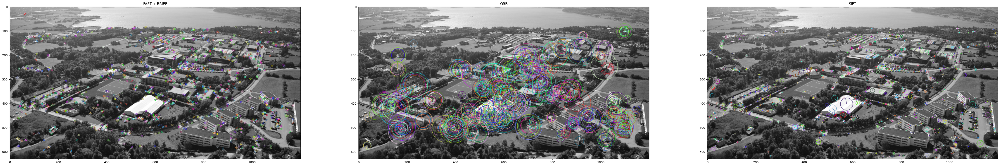

In [32]:
imgNames = ['Campus Ullandhaug mot Hafrsfjord.jpg']
imgs, fastbrief_kps, fastbrief_dess, orb_kps, orb_dess, sift_kps, sift_dess = compare(imgNames,FASTthresh=80,nfeaturesORB=640,nfeaturesSIFT=1280)
plot_comparison(imgs,fastbrief_kps,orb_kps,sift_kps,SideBySide=True)

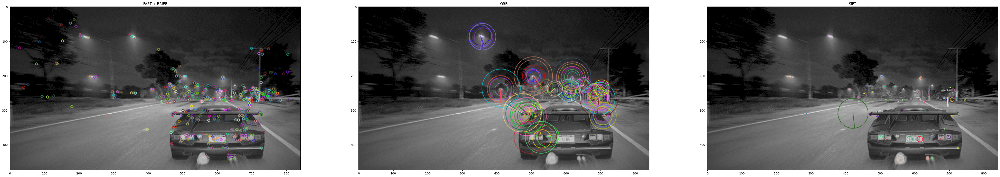

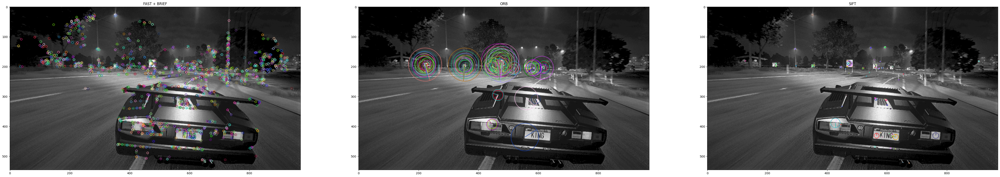

In [43]:
imgNames = ['2022-10-06 (27).png','2022-10-06 (28).png']
imgs, fastbrief_kps, fastbrief_dess, orb_kps, orb_dess, sift_kps, sift_dess = compare(imgNames,FASTthresh=30,nfeaturesORB=100,nfeaturesSIFT=100)
plot_comparison(imgs,fastbrief_kps,orb_kps,sift_kps,SideBySide=True)

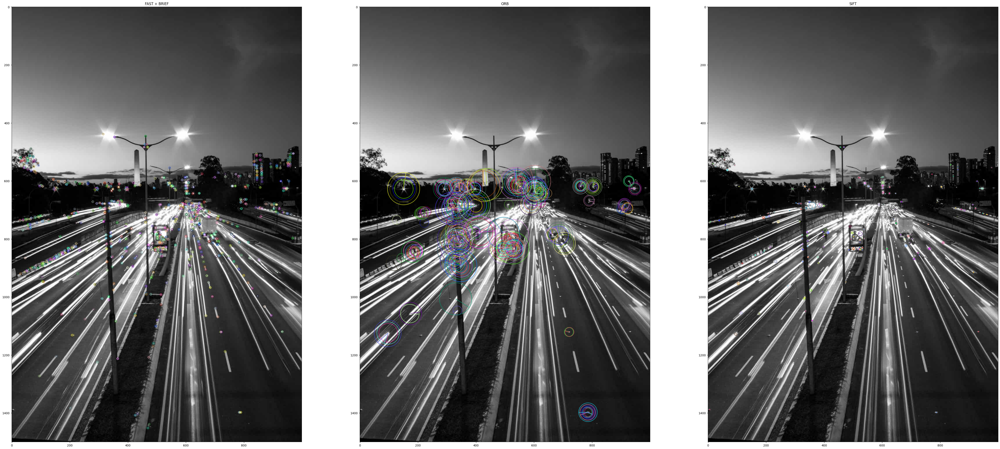

In [34]:
imgNames = ['Car-Light-Trails-4.jpg']
imgs, fastbrief_kps, fastbrief_dess, orb_kps, orb_dess, sift_kps, sift_dess = compare(imgNames,FASTthresh=80,nfeaturesORB=300,nfeaturesSIFT=300)
plot_comparison(imgs,fastbrief_kps,orb_kps,sift_kps,SideBySide=True)

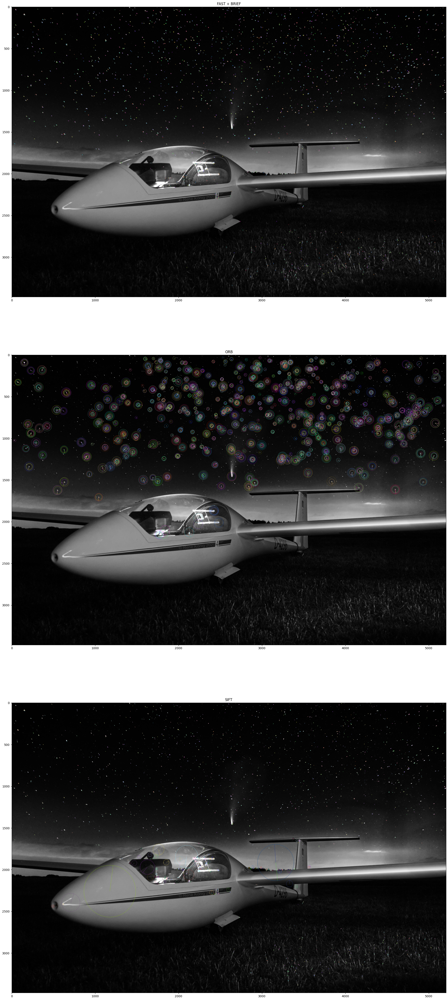

In [38]:
imgNames = ['LS4.jpg']
imgs, fastbrief_kps, fastbrief_dess, orb_kps, orb_dess, sift_kps, sift_dess = compare(imgNames,FASTthresh=50,nfeaturesORB=3000,nfeaturesSIFT=3000)
plot_comparison(imgs,fastbrief_kps,orb_kps,sift_kps,SideBySide=False)
